# 1. Camera Calibration

In [1]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
%matplotlib inline

In [2]:
def drawImagesInARow(imgs, cmaps=None):
    f, axes = plt.subplots(1, len(imgs), figsize=(20, 9))
    f.tight_layout()
    
    for i, img in enumerate(imgs):
        cmap = None if cmaps is None else cmaps[i]
        axes[i].imshow(img, cmap=cmap)
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [3]:
# Read in chessboard images, and compute object and image points
camera_cal_dir = 'camera_cal/'
img_points = []
obj_points = []
nx = 9
ny = 6
obj_point = np.zeros((nx * ny, 3), dtype=np.float32)
obj_point[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape([-1, 2])
imgs = []
img_size = None
for f in os.listdir(camera_cal_dir):
    img = mpimg.imread(camera_cal_dir + f)
    imgs.append(img)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    if img_size is None:
        img_size = gray.shape
        
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny))
    
    if ret:
        img_points.append(corners)
        obj_points.append(obj_point)
        cv2.drawChessboardCorners(img, (nx, ny), corners, True)

In [4]:
# Calibrate camera
ret, cameraMat, distCoeffs, _, _ = cv2.calibrateCamera(obj_points, img_points, img_size[::-1], None, None)

if not ret:
    raise Exception('Camera calibration failed')

def undistort(img):
    return cv2.undistort(img, cameraMat, distCoeffs)

# Undistort chessboard images
undists = []
for img in imgs:
    undist = undistort(img)
    undists.append(undist)

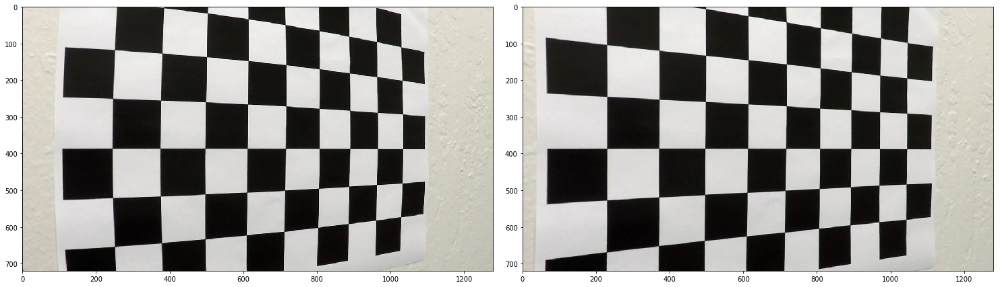

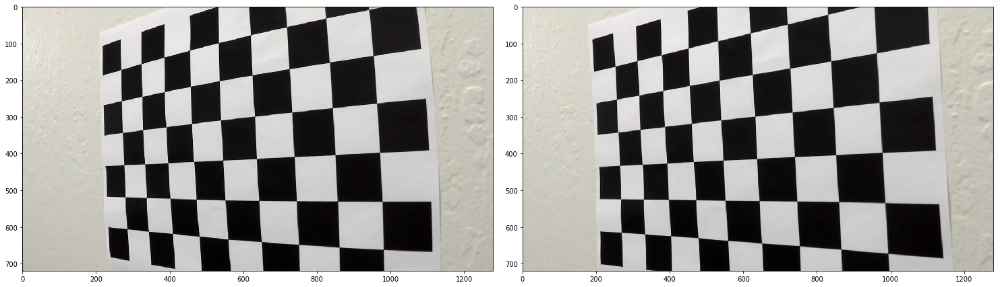

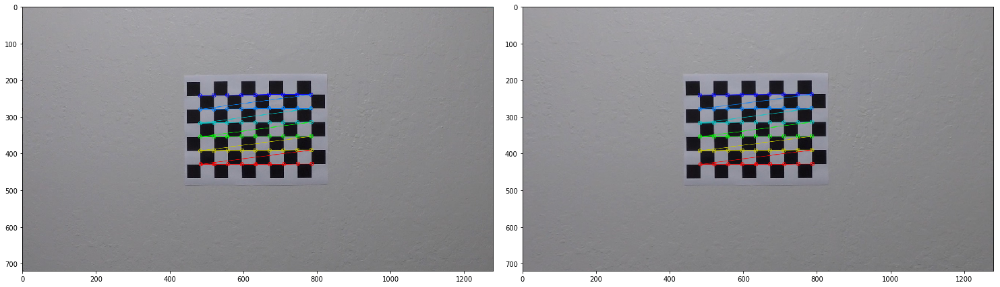

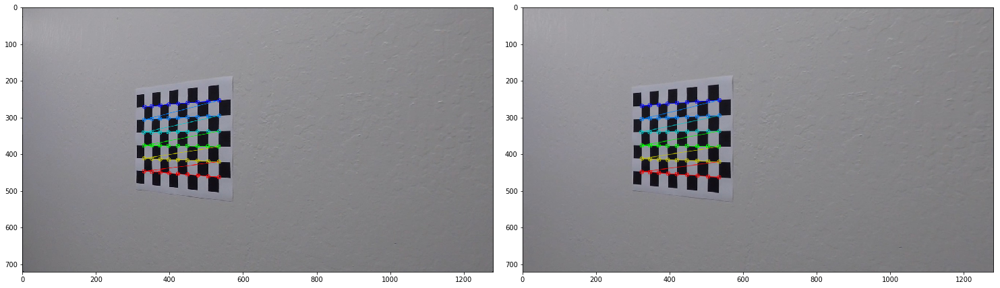

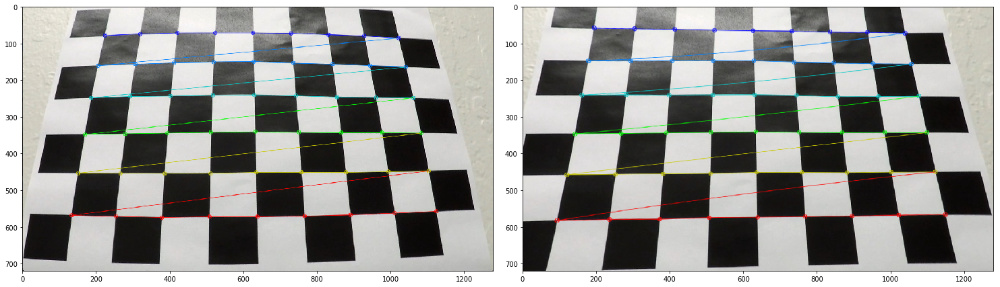

...

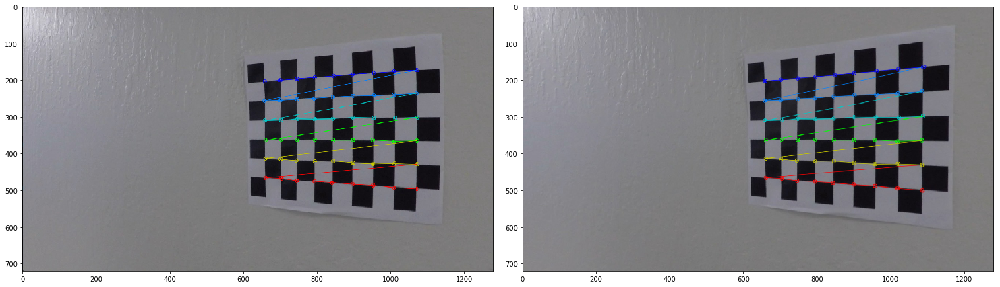

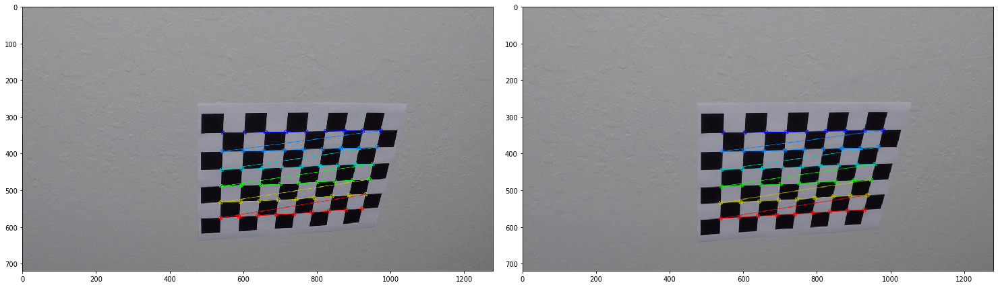

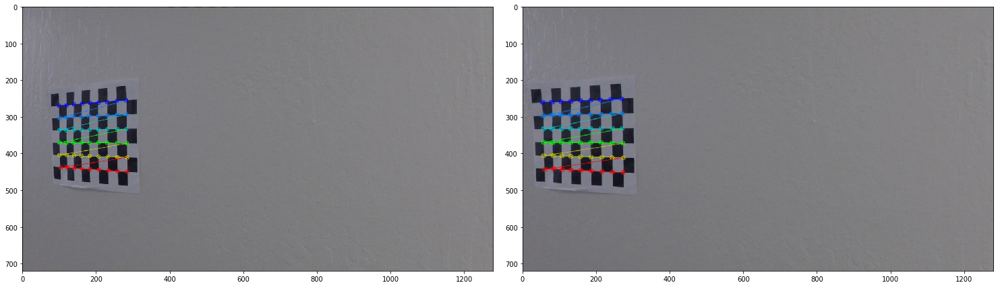

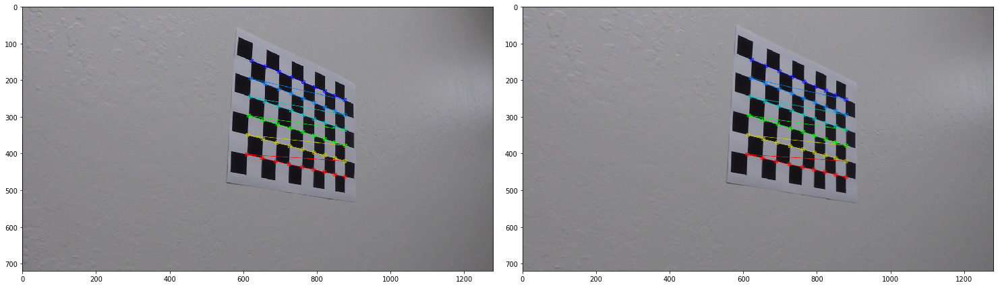

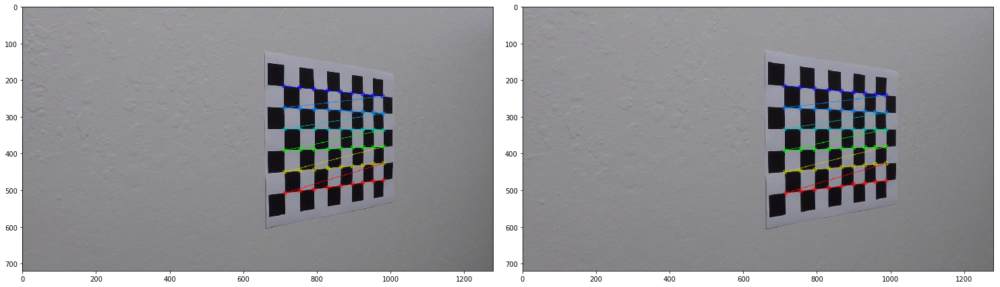

In [5]:
# Draw chessboard images
for dist, undist in zip(imgs, undists):
    drawImagesInARow([dist, undist])

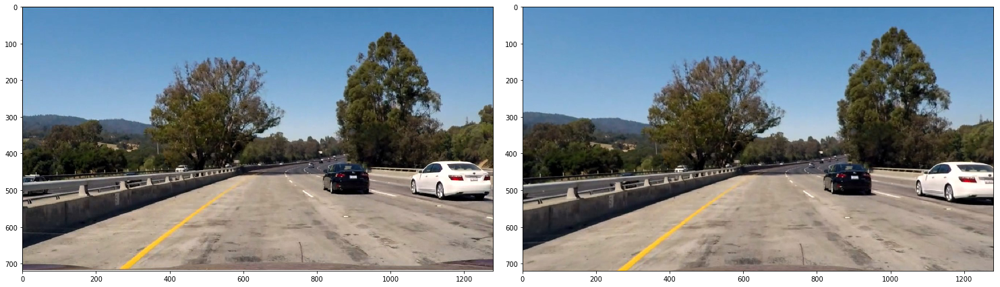

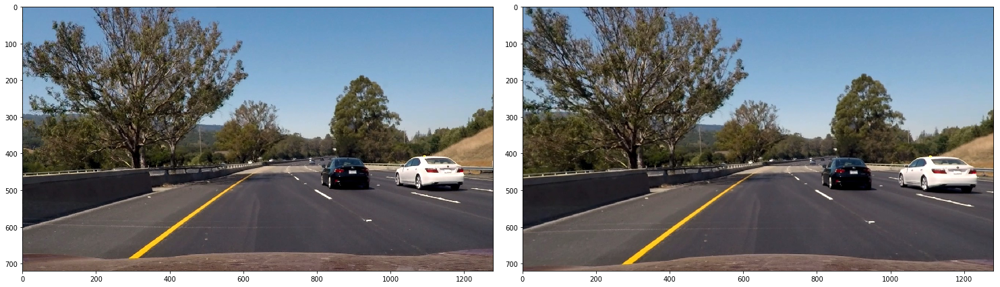

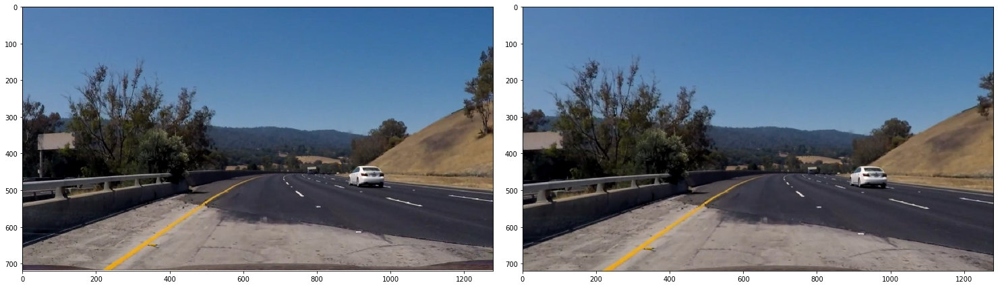

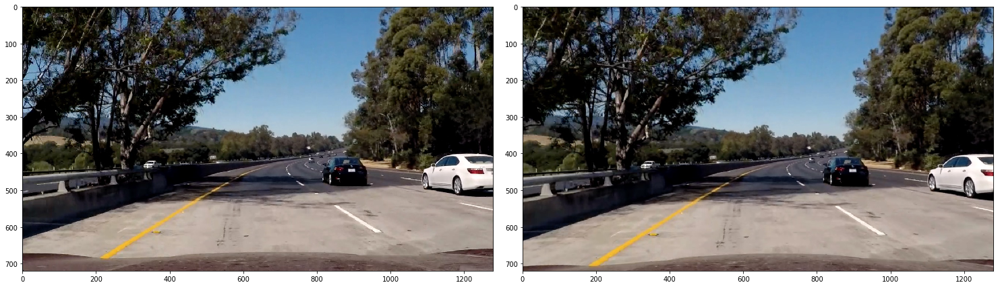

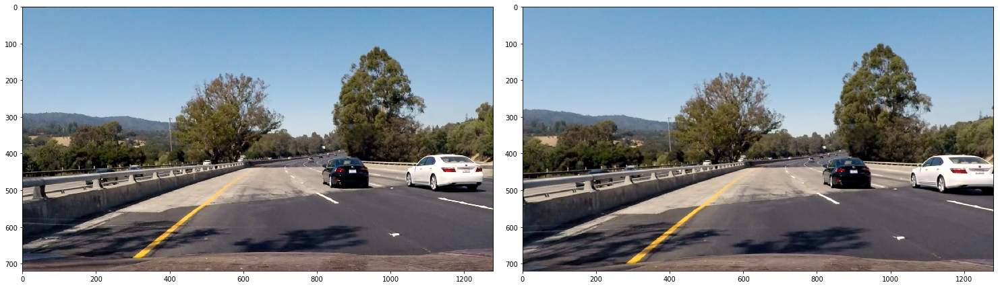

...

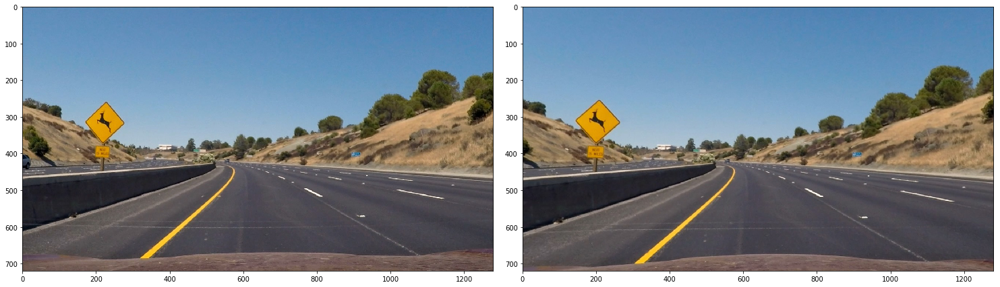

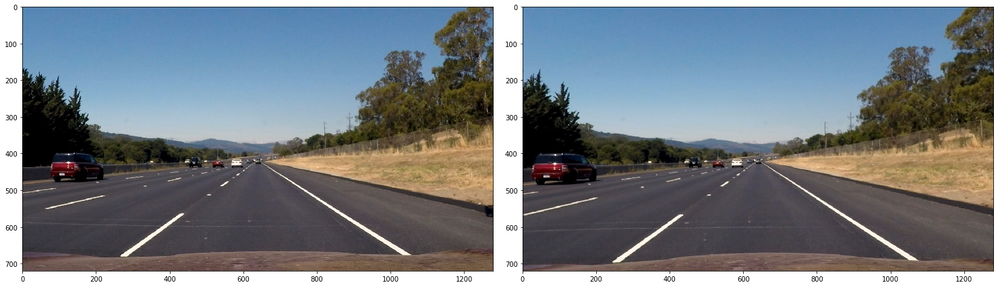

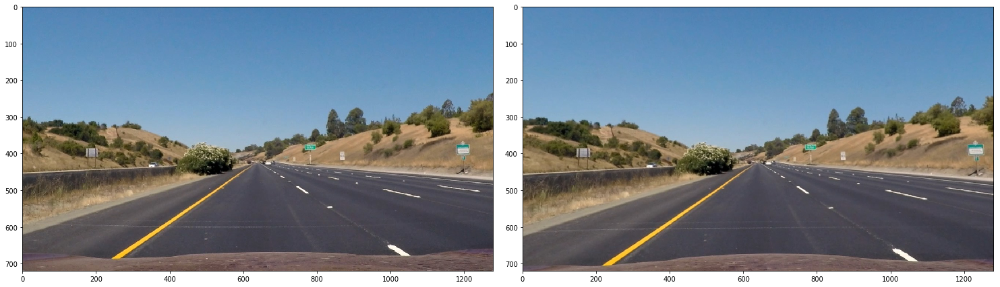

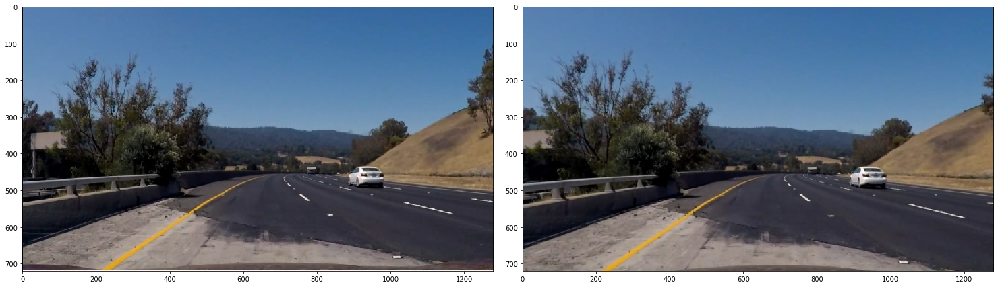

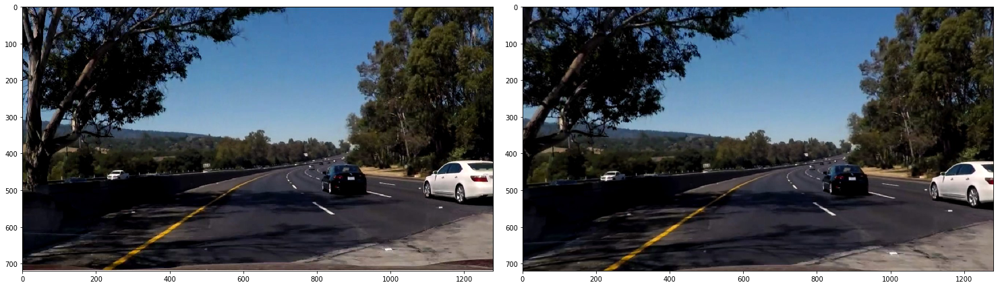

In [6]:
# Read in test images
test_img_dir = 'test_images/'
test_imgs = []
for f in os.listdir(test_img_dir):
    test_img = mpimg.imread(test_img_dir + f)
    test_imgs.append(test_img)
    undist = undistort(test_img)
    drawImagesInARow([test_img, undist])

# 2. Perspective Transformation

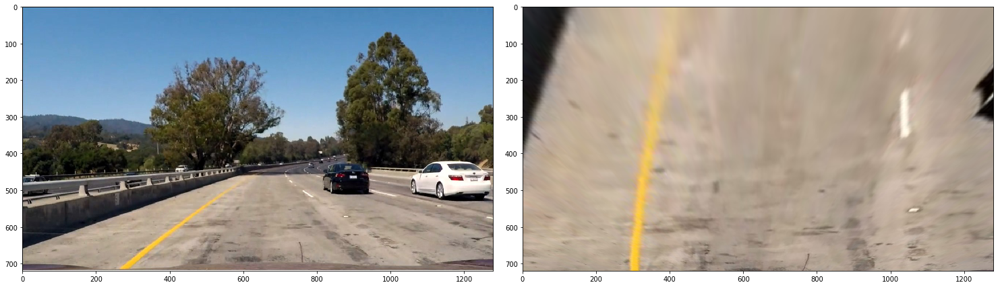

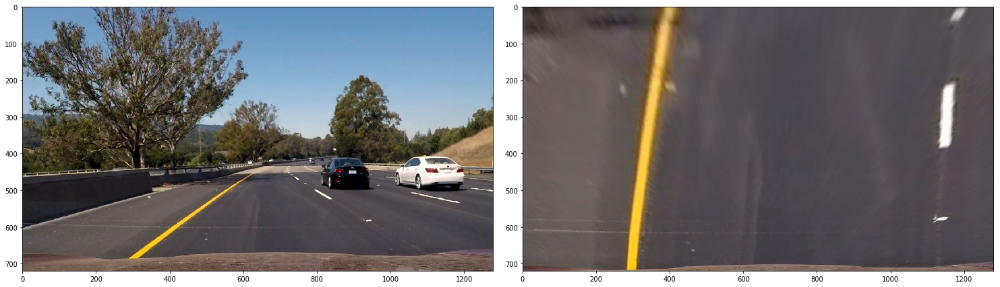

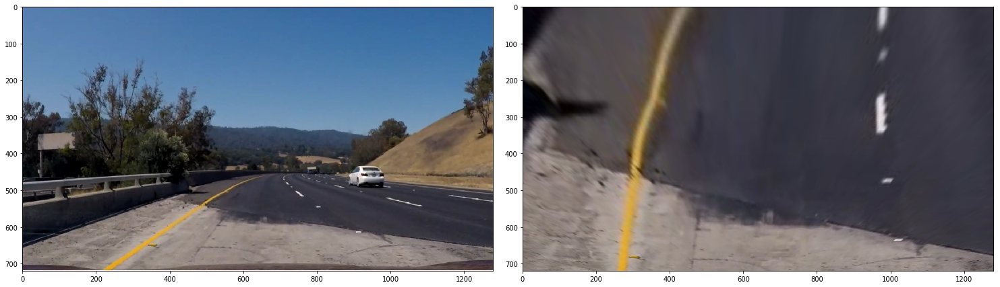

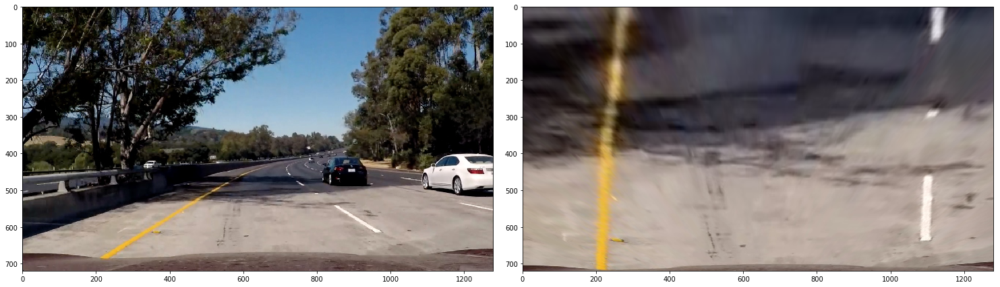

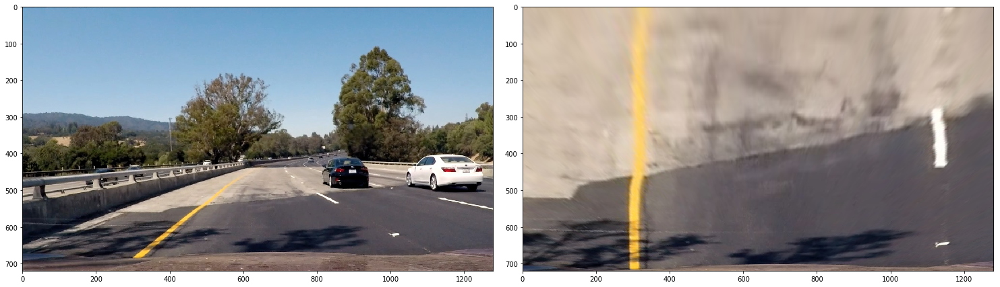

...

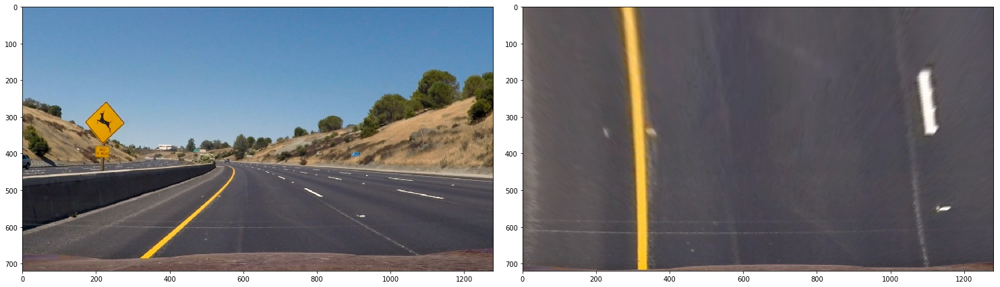

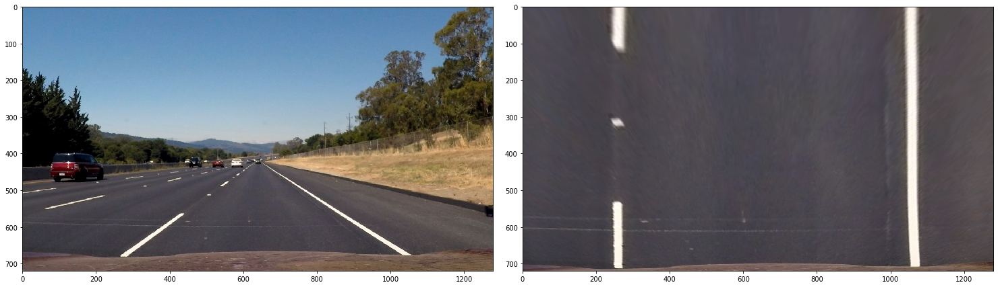

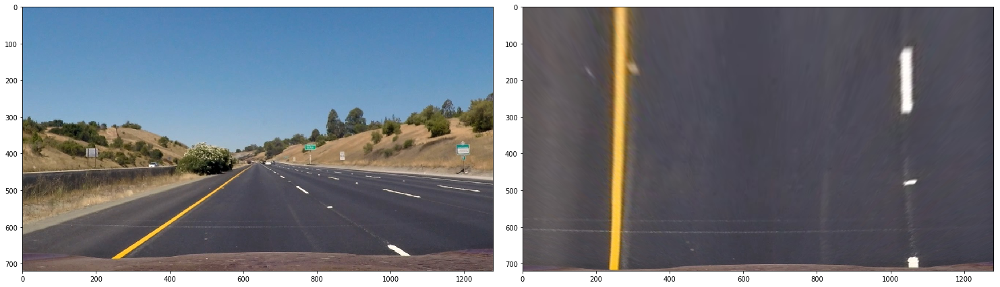

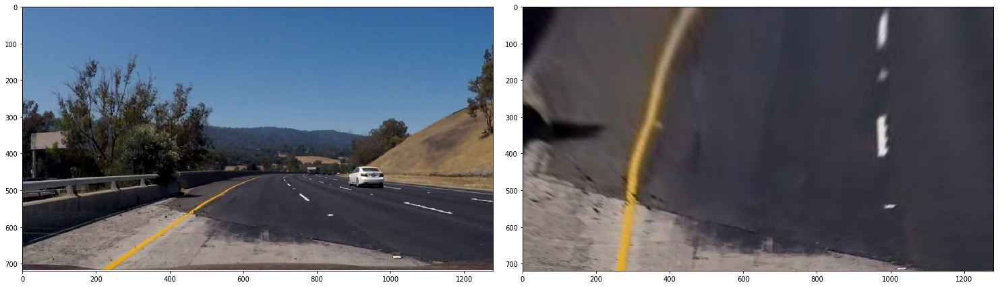

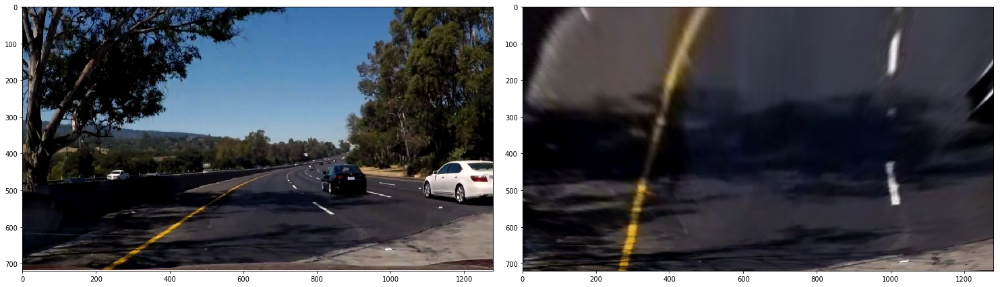

In [7]:
img_w = test_imgs[0].shape[1]
img_h = test_imgs[0].shape[0]

orig_vertices = np.array([(492, 480), (788, 480), (img_w, 690), (0, 690)], dtype=np.float32)
trans_vertices = np.array([(0, 0), (img_w, 0), (img_w, img_h), (0, img_h)], dtype=np.float32)

M = cv2.getPerspectiveTransform(orig_vertices, trans_vertices)
revM = cv2.getPerspectiveTransform(trans_vertices, orig_vertices)

def warp(img):
    return cv2.warpPerspective(img, M, (img_w, img_h))

test_imgs_warped = []
for test_img in test_imgs:   
    warped = warp(test_img)
    test_imgs_warped.append(warped)
    drawImagesInARow([test_img, warped])

# 3. Edge Detection

In [8]:
def sobelx(img):
    '''
    Use Sobel X
    '''
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=9)
    gx = np.absolute(gx)
    gx = np.uint8(255 * gx / np.max(gx))
    ret = np.zeros_like(gray)
    thresh = (15, 200)
    ret[(gx >= thresh[0]) & (gx <= thresh[1])] = 1
    return ret

def s(img):
    '''
    Use the S channel
    '''
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s = hls[:,:,2]
    ret = np.zeros_like(s)
    thresh = (150, 255)
    ret[(s >= thresh[0]) & (s <= thresh[1])] = 1
    return ret

def white(img):
    r = img[:, :, 0]
    g = img[:, :, 1]
    b = img[:, :, 2]
    ret = np.zeros_like(r)
    thresh = (200, 255)
    ret[(r >= thresh[0]) & (r <= thresh[1]) & 
        (g >= thresh[0]) & (g <= thresh[1]) & 
        (b >= thresh[0]) & (b <= thresh[1])] = 1
    return ret

def yellow(img):
    r = img[:, :, 0]
    g = img[:, :, 1]
    b = img[:, :, 2]
    ret = np.zeros_like(r)
    r_thresh = (200, 255)
    g_thresh = (100, 255)
    b_thresh = (0, 150)
    ret[(r >= r_thresh[0]) & (r <= r_thresh[1]) & 
        (g >= g_thresh[0]) & (g <= g_thresh[1]) & 
        (b >= b_thresh[0]) & (b <= b_thresh[1])] = 1
    return ret

def detectEdges(img, show_imgs=False):
    '''
    Take in an RGB img, and return a binary img of edges
    '''
    sobelx_bin = sobelx(img)
    s_bin = s(img)
    
    white_bin = white(img)
    yellow_bin = yellow(img)
    
    combined = np.zeros_like(sobelx_bin)
#     combined[((white_bin == 1) & (sobelx_bin == 1)) | ((yellow_bin == 1) & (s_bin == 1))] = 1
    combined[(white_bin == 1) | (yellow_bin == 1)] = 1
    
    if show_imgs:
        drawImagesInARow([white_bin, yellow_bin, combined], cmaps=['gray', 'gray', 'gray'])
    
    return combined

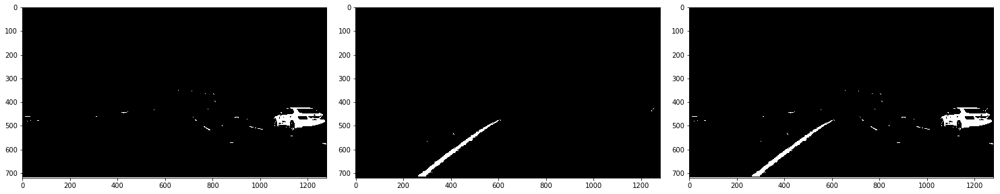

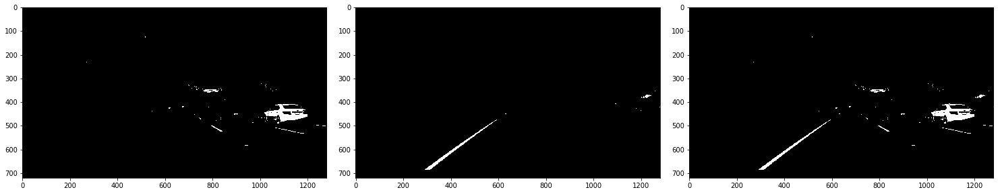

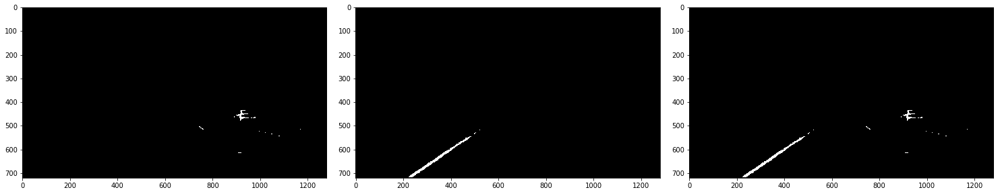

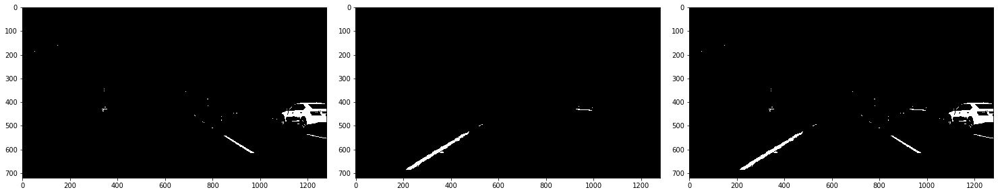

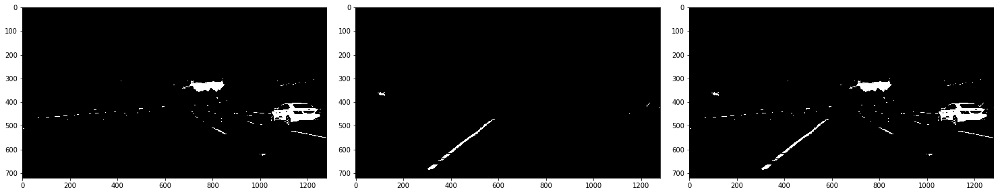

...

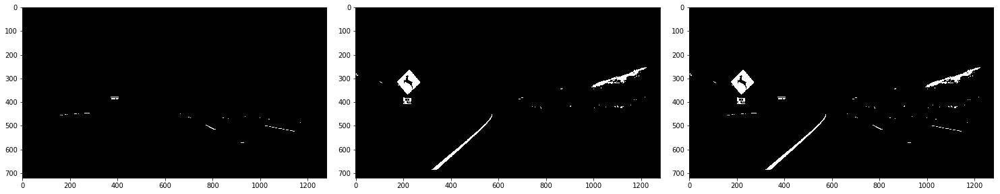

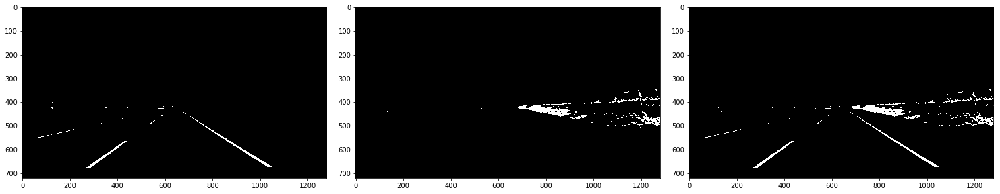

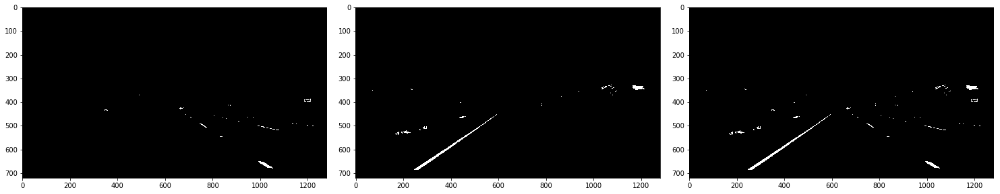

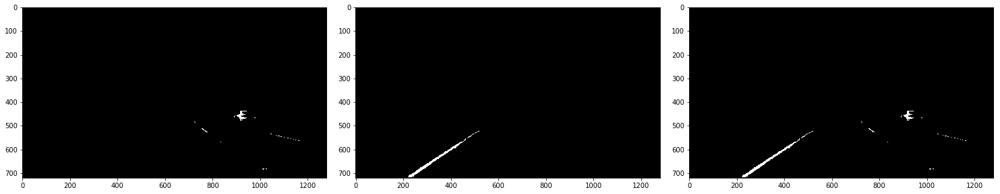

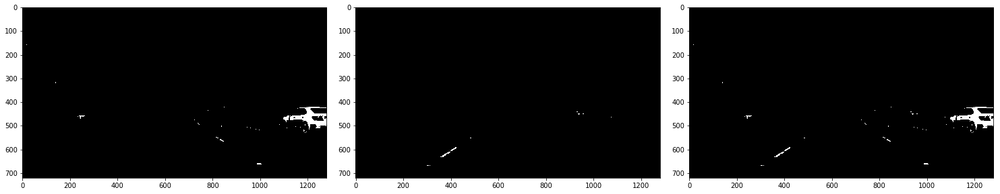

In [9]:
test_edges = []
for img in test_imgs:
    test_edges.append(detectEdges(img, True))

# 4. Lane Finding

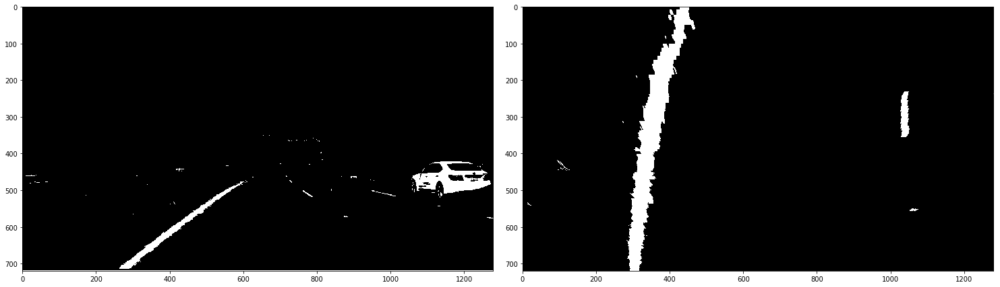

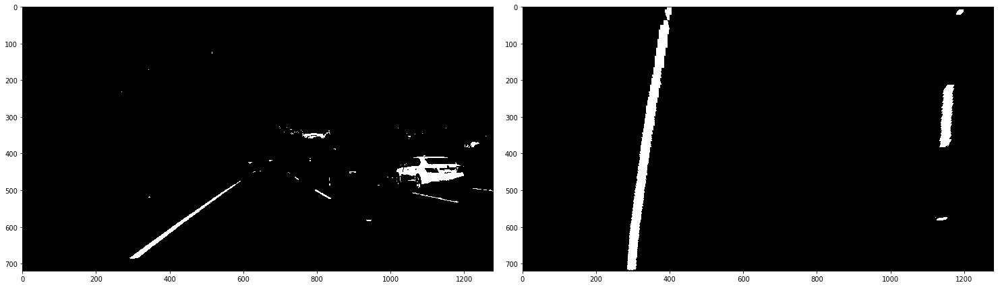

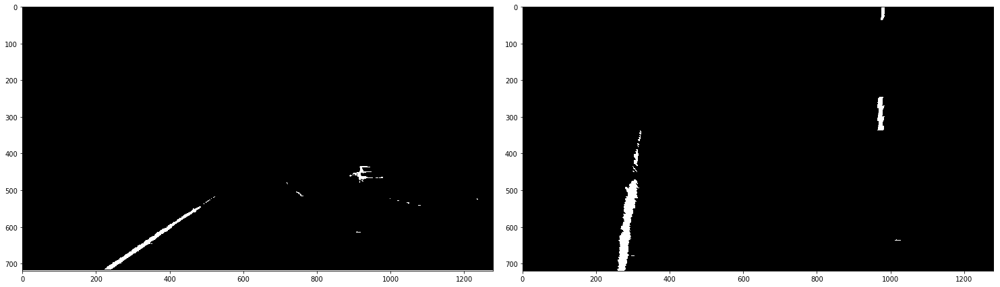

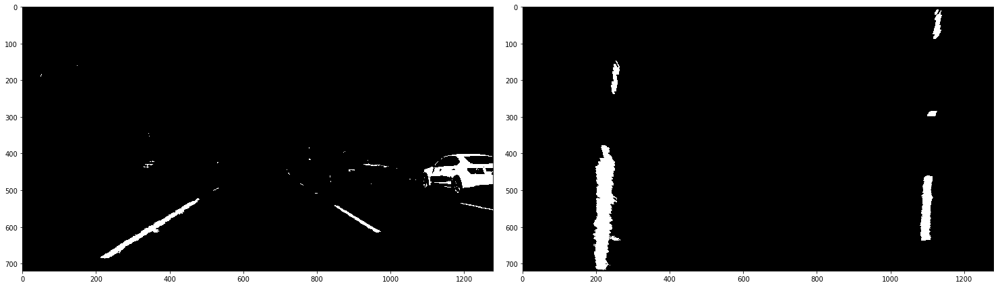

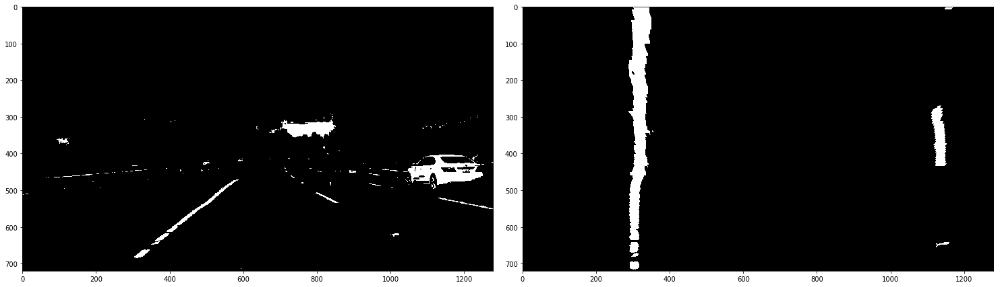

...

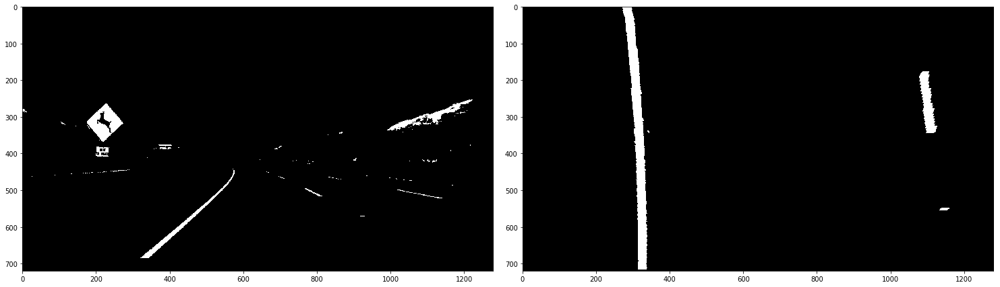

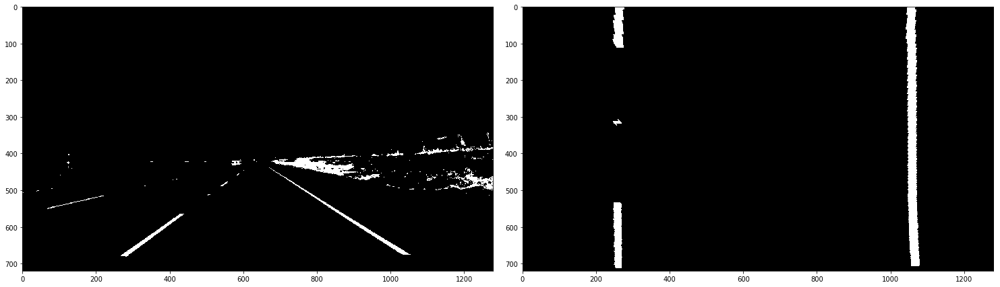

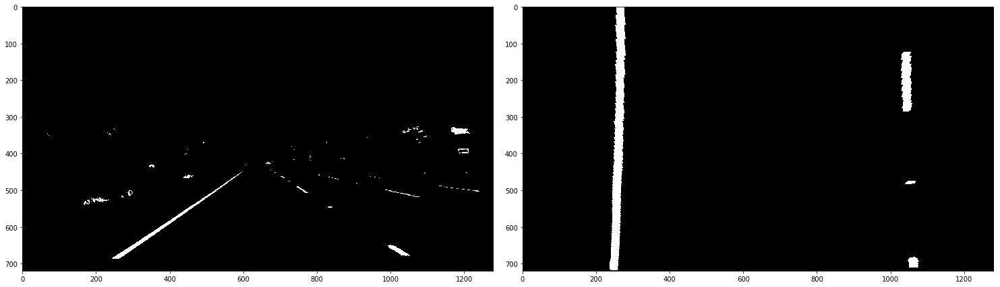

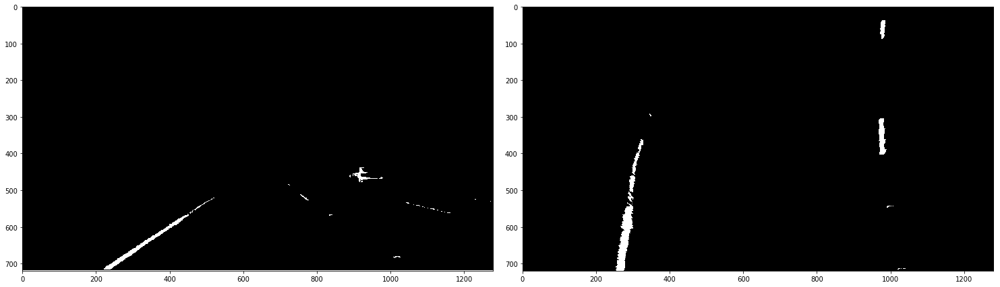

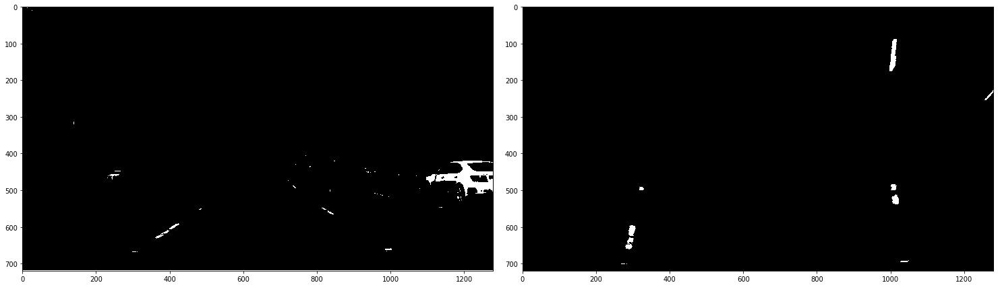

In [10]:
warped_test_edges = []
for edges in test_edges:
    warped_edges = warp(edges)
    warped_test_edges.append(warped_edges)
    drawImagesInARow([edges, warped_edges], ['gray', 'gray'])

In [11]:
window_h = int(img_h / 10)
margin = 50

def findMaxY(warped_edges, x):
    ret = None
    max_sum = 0
    window_x_low = max(0, int(x - margin))
    window_x_high = min(img_w, int(x + margin))
    
    for y in range(0, img_h, window_h):
        tmp_sum = np.sum(warped_edges[y:y+window_h, window_x_low:window_x_high])
        
        if tmp_sum > max_sum:
            max_sum, ret = tmp_sum, y
    
    return ret

def extractNonzero(nonzero_x, nonzero_y, x1, x2, y1, y2):
    idx = ((nonzero_x >= x1) & (nonzero_x < x2) & (nonzero_y >= y1) & (nonzero_y < y2))
    return nonzero_x[idx], nonzero_y[idx]

def findLane(single_lane_edges, start_centroid=None):
    min_pixel = 100
    nz_y, nz_x = single_lane_edges.nonzero()
    ret_nz_x = []
    ret_nz_y = []
    h, w = single_lane_edges.shape
    
    # Find the starting point
#     if start_centroid is None:
    if True:
        hist = np.sum(single_lane_edges, axis=0)
        
        start_x = np.argmax(hist)
        start_y = findMaxY(single_lane_edges, start_x)
        
        if start_y is None:
            return ret_nz_x, ret_nz_y
    else:
        start_x, start_y = start_centroid
    
    # Extract the non-zero points at the starting point
    nz_x_tmp, nz_y_tmp = extractNonzero(nz_x, nz_y, \
                                        max(0, start_x - margin), min(w, start_x + margin), \
                                        start_y, start_y + window_h)
    start_centroid = (int(np.mean(nz_x_tmp)), start_y)
    ret_nz_x.append(nz_x_tmp)
    ret_nz_y.append(nz_y_tmp)
    
    def process(start_centroid, start_y, end_y, y_step):
        prev_centroid = start_centroid
        for y in range(start_y, end_y, y_step):
            nz_x_tmp, nz_y_tmp = extractNonzero(nz_x, nz_y, \
                                                max(0, prev_centroid[0] - margin), min(w, prev_centroid[0] + margin), \
                                                y, y + window_h)
            ret_nz_x.append(nz_x_tmp)
            ret_nz_y.append(nz_y_tmp)
            
            if len(nz_x_tmp) > min_pixel:
                # Update centroid
                prev_centroid = (int(np.mean(nz_x_tmp)), y)
            
    # Extract the non-zero points at all other levels
    process(start_centroid, start_centroid[1] - window_h, -1, -window_h)
    process(start_centroid, start_centroid[1] + window_h, h, window_h)
        
    return np.concatenate(ret_nz_y), np.concatenate(ret_nz_x)
    

def findLanes(warped_edges, prev_left_cent=None, prev_right_cent=None):
    mid = int(warped_edges.shape[1] / 2)
    y_left, x_left = findLane(warped_edges[:, :mid], prev_left_cent)
    y_right, x_right = findLane(warped_edges[:, mid:], prev_right_cent)
    
    if len(x_right) > 0:
        x_right += mid
    
    return y_left, x_left, y_right, x_right

In [12]:
def fitQuadratic(y, x):
    return np.polyfit(y, x, 2)

def calcCurvature(y, x):
    '''
    y and x are in pixels. Returned radius is in real world meters.
    '''
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    quad = fitQuadratic(y*ym_per_pix, x*xm_per_pix)
    
    # Calculate the new radii of curvature
    return ((1 + (2*quad[0]*y[-1]*ym_per_pix + quad[1])**2)**1.5) / np.absolute(2*quad[0])


In [13]:
def drawLaneArea(img, y, left_x, right_x):
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_x, y]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_x, y])))])
    pts = np.hstack((pts_left, pts_right))

    cv2.fillPoly(img, np.int_([pts]), (0,255, 0))

In [14]:
def computeLaneArea(warped_edges, prev_left=None, prev_right=None):
    prev_left_cent = None
    prev_right_cent = None
    
    if prev_left is not None:
        prev_left_cent = prev_left['cent']
        
    if prev_right is not None:
        prev_right_cent = prev_right['cent']
    
    try:
        y_left, x_left, y_right, x_right = findLanes(warped_edges, prev_left_cent, prev_right_cent)
    except:
        plt.figure()
        plt.imshow(warped_edges, 'gray')
        raise
    
    quad_left = fitQuadratic(y_left, x_left) if len(y_left) > 0 else prev_left['quad']
    quad_right = fitQuadratic(y_right, x_right) if len(y_right) > 0 else prev_right['quad']
    
    def shouldReject(line1, line2):
        for i in range(10):
            y = i * window_h
            if abs((line1[0] * y**2 + line1[1] * y + line1[2]) - (line2[0] * y**2 + line2[1] * y + line2[2])) > 100:
                return True
        return False
    
    test_y = img_h - window_h
    
    if prev_left is not None:
        if shouldReject(quad_left, prev_left['quad']):
            quad_left = prev_left['quad']
        else:
            quad_left[0] = quad_left[0] * 0.2 + prev_left['quad'][0] * 0.8
            quad_left[1] = quad_left[1] * 0.2 + prev_left['quad'][1] * 0.8
            quad_left[2] = quad_left[2] * 0.2 + prev_left['quad'][2] * 0.8
        
    if prev_right is not None:
        if shouldReject(quad_right, prev_right['quad']):
            quad_right = prev_right['quad']
        else:
            quad_right[0] = quad_right[0] * 0.2 + prev_right['quad'][0] * 0.8
            quad_right[1] = quad_right[1] * 0.2 + prev_right['quad'][1] * 0.8
            quad_right[2] = quad_right[2] * 0.2 + prev_right['quad'][2] * 0.8
    
    img = np.zeros((img_h, img_w, 3), np.uint8)
    
    y = np.linspace(0, img_h - 1, img_h)
    quad_x_left = quad_left[0] * y**2 + quad_left[1] * y + quad_left[2]
    quad_x_right = quad_right[0] * y**2 + quad_right[1] * y + quad_right[2]
                   
    drawLaneArea(img, y, quad_x_left, quad_x_right)
    rad = calcCurvature(y, quad_x_left)
    lane_cent = (quad_x_right[-1] + quad_x_left[-1]) / 2
    
    cent_y = img_h - window_h
    cent_x_left = quad_left[0] * cent_y**2 + quad_left[1] * cent_y + quad_left[2]
    cent_x_right = quad_right[0] * cent_y**2 + quad_right[1] * cent_y + quad_right[2]
    
    left = {'cent': (cent_x_left, cent_y), 'quad': quad_left}
    right = {'cent': (cent_x_right, cent_y), 'quad': quad_right}
    
    return img, rad, lane_cent, left, right

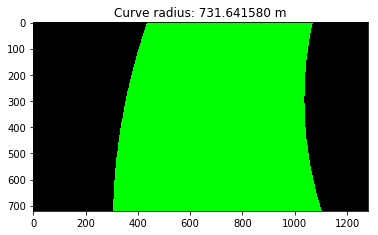

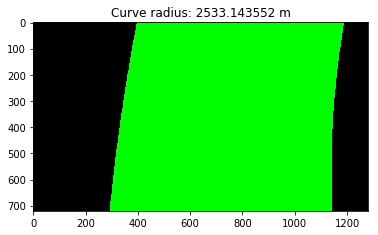

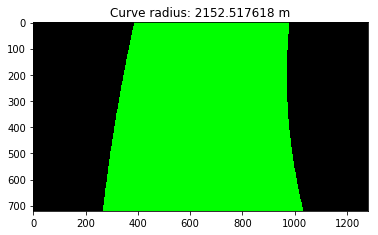

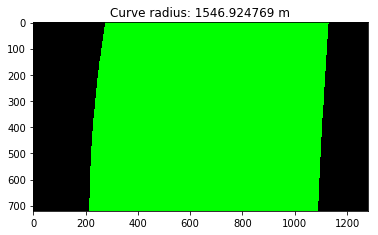

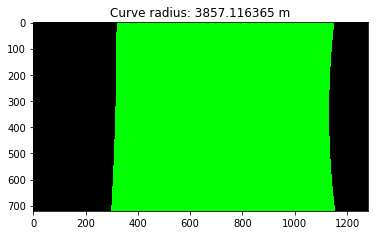

...

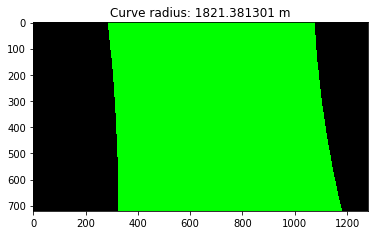

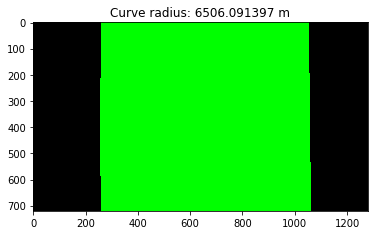

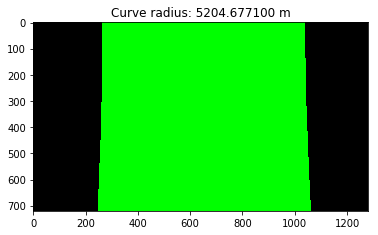

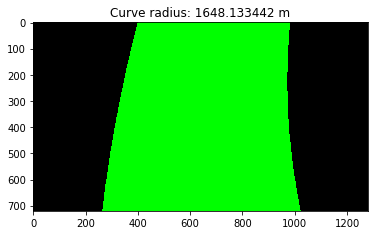

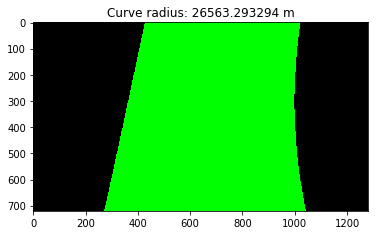

In [15]:
line_imgs = []
curvatures = []
lane_centers = []
for warped_edges in warped_test_edges:
    img, rad, lane_cent, _, _ = computeLaneArea(warped_edges)
    
    lane_centers.append(lane_cent)
    curvatures.append(rad)
    line_imgs.append(img)
    
    plt.figure()
    plt.imshow(img)
    plt.title('Curve radius: %f m' % rad)

# 5. Warp Back

In [24]:
def warpBackAndOverlay(lane_img, orig_img, curv, lane_cent):
    warped_back = cv2.warpPerspective(lane_img, revM, (img_w, img_h))
    result = cv2.addWeighted(orig_img, 1, warped_back, 0.3, 0)
    cv2.putText(result, 'Radius of Curvature: %d(m)' % int(curv), (10, 60), cv2.FONT_HERSHEY_SIMPLEX, 2, (255,255,255), 2, cv2.LINE_AA)
    dist_to_cent = ((lane_cent - img_w / 2) * 3.7 / 700)
    cv2.putText(result, 'Vehicle is %.2f(m) %s of the center' % (dist_to_cent, 'Left' if dist_to_cent > 0 else 'Right'), (10, 130), cv2.FONT_HERSHEY_SIMPLEX, 2, (255,255,255), 2, cv2.LINE_AA)
    
    return result

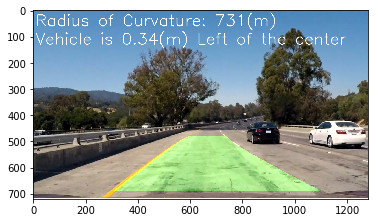

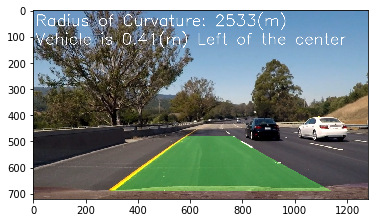

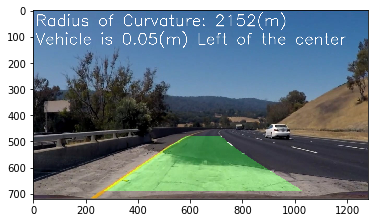

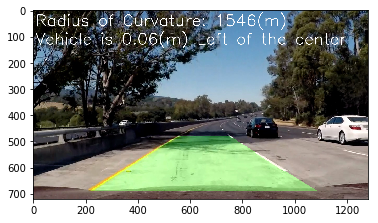

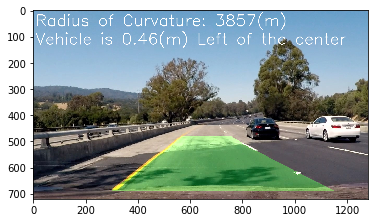

...

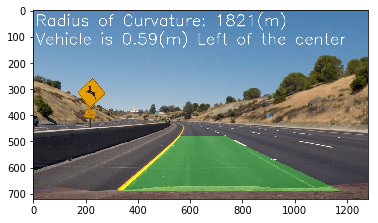

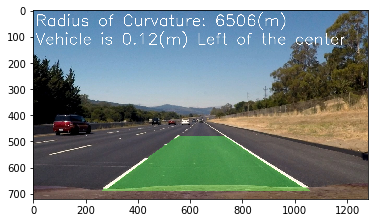

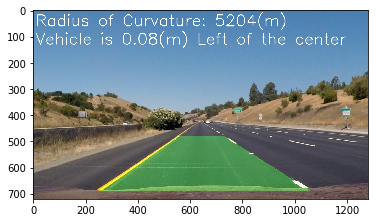

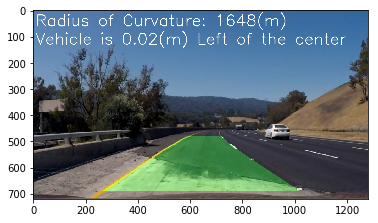

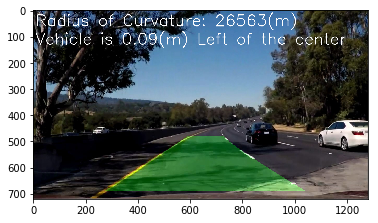

In [25]:
for line_img, test_img, curv, l_c in zip(line_imgs, test_imgs, curvatures, lane_centers):
    plt.figure()
    plt.imshow(warpBackAndOverlay(line_img, test_img, curv, l_c))

# 6. Video

In [28]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [29]:
state = {}
state['prev_left'] = None
state['prev_right'] = None

def process_image(img):
    undistorted = undistort(img)
    edges = detectEdges(undistorted)
    warped = warp(edges)
    try:
        lane_area, rad, lane_cent, left, right = computeLaneArea(warped, state['prev_left'], state['prev_right'])
        state['prev_left'] = left
        state['prev_right'] = right
    except:
        plt.figure()
        plt.imshow(img)
        raise
        
    return warpBackAndOverlay(lane_area, img, rad, lane_cent)

In [30]:
state['prev_left'] = None
state['prev_right'] = None

clip = VideoFileClip("project_video.mp4")
out_clip = clip.fl_image(process_image) #NOTE: this function expects color images!!
%time out_clip.write_videofile("project_video_out.mp4", audio=False)

[MoviePy] >>>> Building video project_video_out.mp4
[MoviePy] Writing video project_video_out.mp4



 24%|██▍       | 300/1261 [00:28<01:28, 10.88it/s]


 46%|████▋     | 584/1261 [00:55<01:02, 10.80it/s]


 70%|███████   | 886/1261 [01:22<00:34, 10.94it/s]


 94%|█████████▎| 1181/1261 [01:50<00:07, 10.73it/s]


100%|█████████▉| 1260/1261 [01:57<00:00, 10.11it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_out.mp4 

CPU times: user 2min 49s, sys: 17.2 s, total: 3min 7s
Wall time: 1min 58s


In [31]:
state['prev_left'] = None
state['prev_right'] = None

clip = VideoFileClip("challenge_video.mp4")
out_clip = clip.fl_image(process_image) #NOTE: this function expects color images!!
%time out_clip.write_videofile("challenge_video_out.mp4", audio=False)

[MoviePy] >>>> Building video challenge_video_out.mp4
[MoviePy] Writing video challenge_video_out.mp4



 64%|██████▎   | 308/485 [00:25<00:15, 11.30it/s]


100%|██████████| 485/485 [00:40<00:00, 12.05it/s]

[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_out.mp4 

CPU times: user 1min 2s, sys: 4.06 s, total: 1min 6s
Wall time: 40.8 s
